In [1]:
import numpy as np
import pandas as pd
import os
import tensorflow as tf
from tensorflow.keras.layers import Lambda
from tqdm import tqdm
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from textwrap import wrap
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import Sequence
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D, Activation, Dropout, Flatten, Dense, Input, Layer
from tensorflow.keras.layers import Embedding, LSTM, add, Concatenate, Reshape, concatenate, Bidirectional
from tensorflow.keras.applications import VGG16, ResNet50, DenseNet201
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.efficientnet import preprocess_input
from tensorflow.keras.applications.resnet50 import preprocess_input
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
import warnings
import re
import matplotlib.pyplot as plt
import seaborn as sns
from textwrap import wrap
import nltk
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction

plt.rcParams['font.size'] = 12
sns.set_style("dark")
warnings.filterwarnings('ignore')

2024-07-29 17:12:47.424914: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-07-29 17:12:47.425066: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-07-29 17:12:47.558637: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [2]:
!pip install kaggle



In [3]:
#from google.colab import files
#files.upload()


In [4]:
#!mkdir -p ~/.kaggle


In [5]:
#!cp kaggle.json ~/.kaggle/


cp: cannot stat 'kaggle.json': No such file or directory


In [6]:
#!chmod 600 ~/.kaggle/kaggle.json


chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [7]:
!kaggle datasets download -d adityajn105/flickr8k


Dataset URL: https://www.kaggle.com/datasets/adityajn105/flickr8k
License(s): CC0-1.0
100%|██████████████████████████████████████▉| 1.03G/1.04G [00:03<00:00, 312MB/s]
100%|███████████████████████████████████████| 1.04G/1.04G [00:03<00:00, 288MB/s]


In [23]:
'''import zipfile
import os

# Create a directory for the dataset
os.makedirs('/content/flickr8k', exist_ok=True)

# Unzip the dataset
with zipfile.ZipFile('flickr8k.zip', 'r') as zip_ref:
    zip_ref.extractall('/content/flickr8k')'''


"import zipfile\nimport os\n\n# Create a directory for the dataset\nos.makedirs('/content/flickr8k', exist_ok=True)\n\n# Unzip the dataset\nwith zipfile.ZipFile('flickr8k.zip', 'r') as zip_ref:\n    zip_ref.extractall('/content/flickr8k')"

In [2]:
image_path = '/kaggle/input/flickr8k/Images'
captions_path = '/kaggle/input/flickr8k/captions.txt'

# Load the captions data
data = pd.read_csv(captions_path)
print(data.head(10))
data.shape


                       image  \
0  1000268201_693b08cb0e.jpg   
1  1000268201_693b08cb0e.jpg   
2  1000268201_693b08cb0e.jpg   
3  1000268201_693b08cb0e.jpg   
4  1000268201_693b08cb0e.jpg   
5  1001773457_577c3a7d70.jpg   
6  1001773457_577c3a7d70.jpg   
7  1001773457_577c3a7d70.jpg   
8  1001773457_577c3a7d70.jpg   
9  1001773457_577c3a7d70.jpg   

                                             caption  
0  A child in a pink dress is climbing up a set o...  
1              A girl going into a wooden building .  
2   A little girl climbing into a wooden playhouse .  
3  A little girl climbing the stairs to her playh...  
4  A little girl in a pink dress going into a woo...  
5         A black dog and a spotted dog are fighting  
6  A black dog and a tri-colored dog playing with...  
7  A black dog and a white dog with brown spots a...  
8  Two dogs of different breeds looking at each o...  
9    Two dogs on pavement moving toward each other .  


(40455, 2)

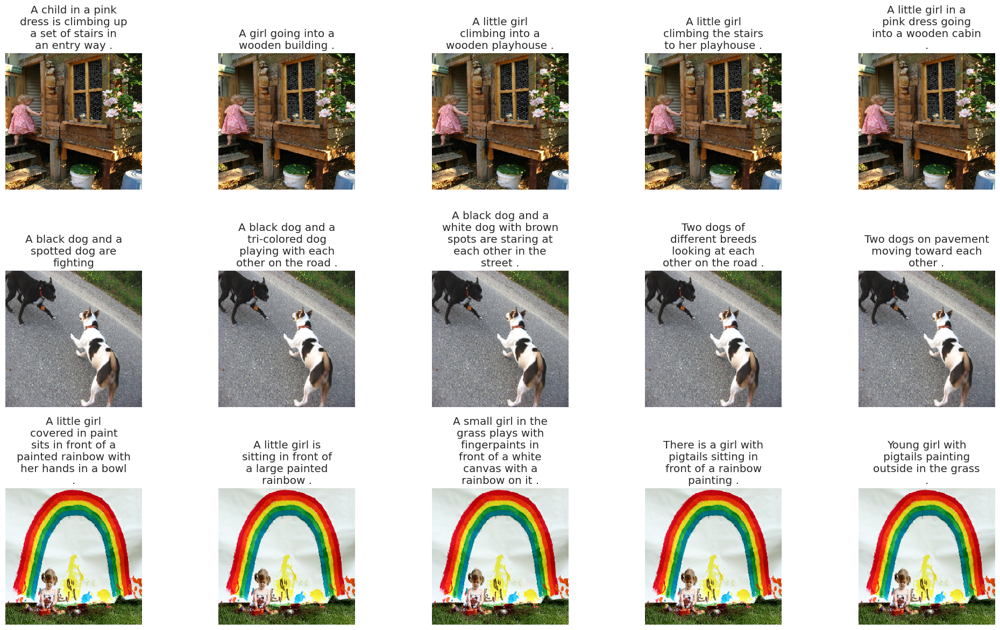

In [3]:
def readImage(path, img_size=224):
    """Load and preprocess an image from the given path."""
    try:
        img = load_img(path, color_mode='rgb', target_size=(img_size, img_size))
        img = img_to_array(img)
        img = img / 255.  # Normalize to [0, 1]
        return img
    except Exception as e:
        print(f"Error loading image from path {path}: {e}")
        return None

def display_images(temp_df):
    """Display images from DataFrame with captions."""
    temp_df = temp_df.reset_index(drop=True)
    plt.figure(figsize=(20, 20))
    plt.subplots_adjust(hspace=0.7, wspace=0.3)

    for i in range(min(15, len(temp_df))):  # Ensure we don't exceed the number of images
        img_path = os.path.join(image_path, temp_df.image[i])  # Correct the path
        image = readImage(img_path)

        if image is not None:
            plt.subplot(5, 5, i + 1)
            plt.imshow(image)
            plt.title("\n".join(wrap(temp_df.caption[i], 20)))
            plt.axis("off")

    plt.tight_layout()
    plt.show()

# Example usage
display_images(data)


In [4]:
def text_preprocessing(data):
    """Preprocess text captions for the image captioning model."""
    # Convert to lowercase
    data['caption'] = data['caption'].apply(lambda x: x.lower())

    # Remove special characters and punctuations
    data['caption'] = data['caption'].apply(lambda x: re.sub(r'[^a-z\s]', '', x))

    # Replace multiple spaces with a single space
    data['caption'] = data['caption'].apply(lambda x: re.sub(r'\s+', ' ', x).strip())

    # Remove single characters
    data['caption'] = data['caption'].apply(lambda x: ' '.join([word for word in x.split() if len(word) > 1]))

    # Add start and end tokens
    data['caption'] = "startseq " + data['caption'] + " endseq"

    return data

# Apply text preprocessing
data = text_preprocessing(data)
captions = data['caption'].tolist()
print(captions[:10])

['startseq child in pink dress is climbing up set of stairs in an entry way endseq', 'startseq girl going into wooden building endseq', 'startseq little girl climbing into wooden playhouse endseq', 'startseq little girl climbing the stairs to her playhouse endseq', 'startseq little girl in pink dress going into wooden cabin endseq', 'startseq black dog and spotted dog are fighting endseq', 'startseq black dog and tricolored dog playing with each other on the road endseq', 'startseq black dog and white dog with brown spots are staring at each other in the street endseq', 'startseq two dogs of different breeds looking at each other on the road endseq', 'startseq two dogs on pavement moving toward each other endseq']


In [5]:
# Initialize the tokenizer and fit on captions
tokenizer = Tokenizer()
tokenizer.fit_on_texts(captions)

# Vocabulary size + 1 for the padding token
vocab_size = len(tokenizer.word_index) + 1

# Maximum length of the captions
max_length = max(len(caption.split()) for caption in captions)

print(f"Vocabulary size: {vocab_size}")
print(f"Maximum caption length: {max_length}")

# Convert captions to sequences
print(([captions[1]])[0])
print(tokenizer.texts_to_sequences([captions[1]])[0])


Vocabulary size: 8768
Maximum caption length: 34
startseq girl going into wooden building endseq
[1, 18, 312, 63, 192, 116, 2]


In [7]:
# Split dataset into training and validation sets
images = data['image'].unique().tolist()
nimages = len(images)

split_index = round(0.85 * nimages)
train_images = images[:split_index]
val_images = images[split_index:]

train = data[data['image'].isin(train_images)]
test = data[data['image'].isin(val_images)]

train.reset_index(inplace=True, drop=True)
test.reset_index(inplace=True, drop=True)


In [8]:
train.shape

(34385, 2)

In [9]:
test.shape

(6070, 2)

In [10]:
# Initialize ResNet50 model for feature extraction
resnet_model = ResNet50(include_top=False, pooling='avg', input_shape=(224, 224, 3), weights='imagenet')
resnet_fe = Model(inputs=resnet_model.input, outputs=resnet_model.layers[-1].output)

img_size = 224
features_resnet = {}

for image in tqdm(data['image'].unique().tolist()):
    img_path = os.path.join(image_path, image)
    img = load_img(img_path, target_size=(img_size, img_size))
    img = img_to_array(img)
    img = preprocess_input(img)  
    img = np.expand_dims(img, axis=0)

    feature = resnet_fe.predict(img, verbose=0)
    features_resnet[image] = feature.flatten() 

# Convert features dictionary to numpy array
feature_list_resnet = np.array([features_resnet[img] for img in images])
print(feature_list_resnet.shape) 




94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


  0%|          | 0/8091 [00:00<?, ?it/s]WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
I0000 00:00:1722273265.603396     121 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.
100%|██████████| 8091/8091 [10:48<00:00, 12.48it/s]

(8091, 2048)


In [11]:

class CustomDataGenerator(Sequence):

    def __init__(self, df, X_col, y_col, batch_size, directory, tokenizer,
                 vocab_size, max_length, features, shuffle=True):
        self.df = df.copy()
        self.X_col = X_col
        self.y_col = y_col
        self.directory = directory
        self.batch_size = batch_size
        self.tokenizer = tokenizer
        self.vocab_size = vocab_size
        self.max_length = max_length
        self.features = features
        self.shuffle = shuffle
        self.n = len(self.df)

    def on_epoch_end(self):
        if self.shuffle:
            self.df = self.df.sample(frac=1).reset_index(drop=True)

    def __len__(self):
        return int(np.ceil(self.n / self.batch_size))

    def __getitem__(self, index):
        batch = self.df.iloc[index * self.batch_size:(index + 1) * self.batch_size, :]
        X1, X2, y = self.__get_data(batch)
        return (X1, X2), y

    def __get_data(self, batch):
        X1, X2, y = list(), list(), list()
        images = batch[self.X_col].tolist()

        for image in images:
            feature = self.features[image]
            captions = batch.loc[batch[self.X_col] == image, self.y_col].tolist()
            for caption in captions:
                seq = self.tokenizer.texts_to_sequences([caption])[0]

                for i in range(1, len(seq)):
                    in_seq, out_seq = seq[:i], seq[i]
                    in_seq = pad_sequences([in_seq], maxlen=self.max_length)[0]
                    out_seq = to_categorical([out_seq], num_classes=self.vocab_size)[0]
                    X1.append(feature)
                    X2.append(in_seq)
                    y.append(out_seq)

        X1, X2, y = np.array(X1), np.array(X2), np.array(y)
        return X1, X2, y

In [12]:
# Define the model
input1 = Input(shape=(feature_list_resnet.shape[1],))  # Feature vector size
input2 = Input(shape=(max_length,))  # Caption sequence length

# Image feature model
img_features = Dense(256, activation='relu')(input1)
img_features_reshaped = Reshape((1, 256))(img_features)  # Reshape to (batch_size, 1, 256)

# Caption model
sentence_features = Embedding(vocab_size, 256, mask_zero=True)(input2)

# Ensure the shapes are compatible for concatenation
# Use Lambda to handle concatenation along the correct axis
def concat_tensor(tensors):
    img_tensor, cap_tensor = tensors
    cap_shape = tf.shape(cap_tensor)
    img_tensor = tf.tile(img_tensor, multiples=[1, cap_shape[1], 1])
    return tf.concat([img_tensor, cap_tensor], axis=2)

merged = Lambda(concat_tensor)([img_features_reshaped, sentence_features])

# Continue with LSTM and dense layers
sentence_features = LSTM(256)(merged)
x = Dropout(0.5)(sentence_features)
x = add([x, img_features])
x = Dense(128, activation='relu')(x)
x = Dropout(0.5)(x)
output = Dense(vocab_size, activation='softmax')(x)

caption_model_resnet = Model(inputs=[input1, input2], outputs=output)
caption_model_resnet.compile(loss='categorical_crossentropy', optimizer='adam')

# Print model summary
caption_model_resnet.summary()


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 2048)      │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense (Dense)       │ (None, 256)       │    524,544 │ input_layer_1[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_layer_2       │ (None, 34)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reshape (Reshape)   │ (None, 1, 256)    │          0 │ dense[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding           │ (None, 34, 256)   │  2,244,608 │ input_layer_2[0]… │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ not_equal           │ (None, 34)        │          0 │ input_layer_2[0]… │
│ (NotEqual)          │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lambda (Lambda)     │ (None, 34, 512)   │          0 │ reshape[0][0],    │
│                     │                   │            │ embedding[0][0],  │
│                     │                   │            │ not_equal[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lstm (LSTM)         │ (None, 256)       │    787,456 │ lambda[0][0]      │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout (Dropout)   │ (None, 256)       │          0 │ lstm[0][0]        │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, 256)       │          0 │ dropout[0][0],    │
│                     │                   │            │ dense[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_1 (Dense)     │ (None, 128)       │     32,896 │ add[0][0]         │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_1 (Dropout) │ (None, 128)       │          0 │ dense_1[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_2 (Dense)     │ (None, 8768)      │  1,131,072 │ dropout_1[0][0]   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 4,720,576 (18.01 MB)

 Trainable params: 4,720,576 (18.01 MB)

 Non-trainable params: 0 (0.00 B)

In [16]:
#from tensorflow.keras.utils import plot_model
#plot_model(caption_model)

In [15]:
train_generator = CustomDataGenerator(df=train, X_col='image', y_col='caption', batch_size=64, directory=image_path,
                                      tokenizer=tokenizer, vocab_size=vocab_size, max_length=max_length, features=features_resnet)

validation_generator = CustomDataGenerator(df=test, X_col='image', y_col='caption', batch_size=64, directory=image_path,
                                      tokenizer=tokenizer, vocab_size=vocab_size, max_length=max_length, features=features_resnet)
model_name = "model_resenet.keras"
checkpoint = ModelCheckpoint(model_name,
                            monitor="val_loss",
                            mode="min",
                            save_best_only=True,
                            verbose=1)

earlystopping = EarlyStopping(monitor='val_loss', min_delta=0, patience=5, verbose=1, restore_best_weights=True)

learning_rate_reduction = ReduceLROnPlateau(monitor='val_loss',
                                            patience=3,
                                            verbose=1,
                                            factor=0.2,
                                            min_lr=0.00000001)

history_resnet = caption_model_resnet.fit(
        train_generator,
        epochs=20,
        validation_data=validation_generator,
        callbacks=[checkpoint, earlystopping, learning_rate_reduction])

Epoch 1/20
538/538 ━━━━━━━━━━━━━━━━━━━━ 0s 504ms/step - loss: 3.5584
Epoch 1: val_loss improved from inf to 3.66592, saving model to model_resenet.keras
538/538 ━━━━━━━━━━━━━━━━━━━━ 324s 596ms/step - loss: 3.5584 - val_loss: 3.6659 - learning_rate: 0.0010
Epoch 2/20
538/538 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step - loss: 3.4421
Epoch 2: val_loss improved from 3.66592 to 3.63919, saving model to model_resenet.keras
538/538 ━━━━━━━━━━━━━━━━━━━━ 86s 158ms/step - loss: 3.4421 - val_loss: 3.6392 - learning_rate: 0.0010
Epoch 3/20
537/538 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 3.3797
Epoch 3: val_loss improved from 3.63919 to 3.63900, saving model to model_resenet.keras
538/538 ━━━━━━━━━━━━━━━━━━━━ 84s 153ms/step - loss: 3.3798 - val_loss: 3.6390 - learning_rate: 0.0010
Epoch 4/20
538/538 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step - loss: 3.3144
Epoch 4: val_loss did not improve from 3.63900
538/538 ━━━━━━━━━━━━━━━━━━━━ 83s 152ms/step - loss: 3.3145 - val_loss: 3.6515 - learning_rate: 0.0010
Epoch 5/

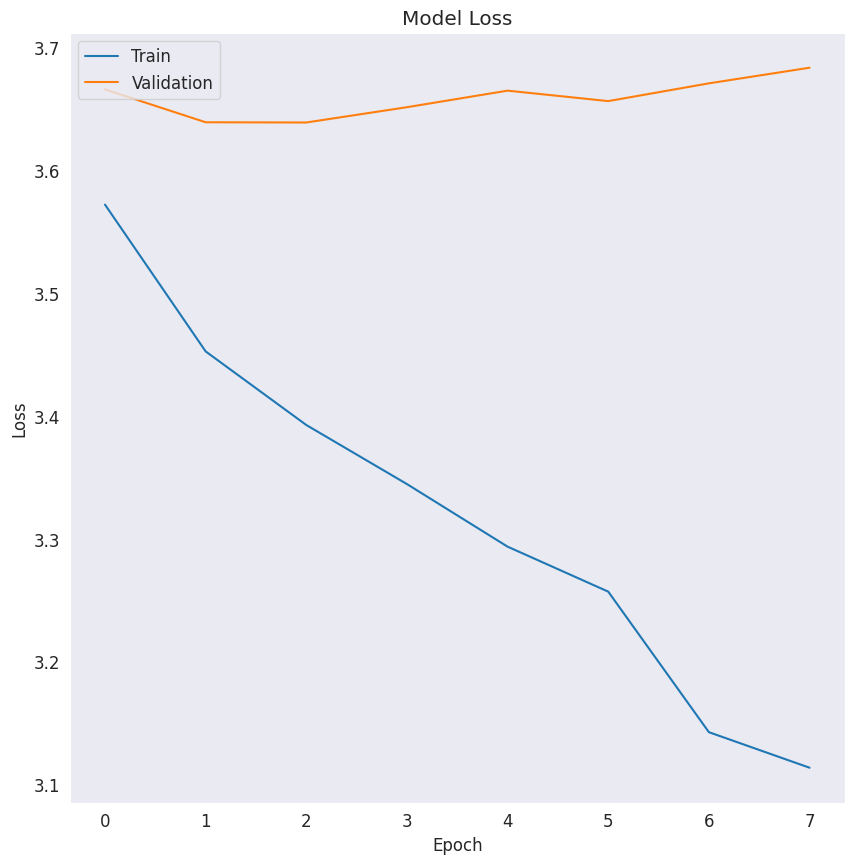

In [37]:
plt.figure(figsize=(10,10))
plt.plot(history_resnet.history['loss'])
plt.plot(history_resnet.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Average BLEU-1 Score: 0.31546816923461163
Average BLEU-2 Score: 0.130996684759461
Average BLEU-3 Score: 0.061421889115557446


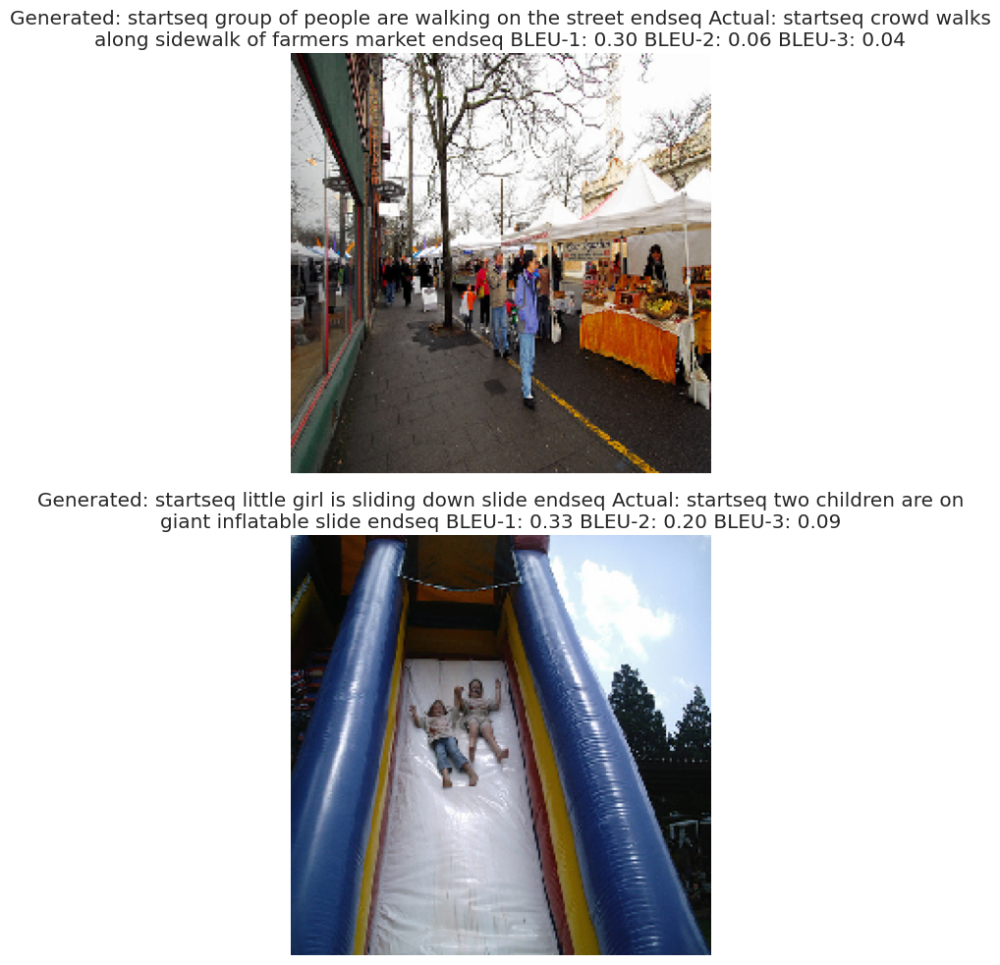

In [17]:
def idx_to_word(integer, tokenizer):
    """Convert an integer to a word."""
    for word, index in tokenizer.word_index.items():
        if index == integer:
            return word
    return None

def predict_caption(model, image, tokenizer, max_length, features):
    """Predict a caption for a given image."""
    feature = features[image]
    in_text = "startseq"
    for i in range(max_length):
        sequence = tokenizer.texts_to_sequences([in_text])[0]
        sequence = pad_sequences([sequence], maxlen=max_length)

        y_pred = model.predict([np.array([feature]), sequence])
        y_pred = np.argmax(y_pred)

        word = idx_to_word(y_pred, tokenizer)
        if word is None:
            break
        in_text += " " + word

        if word == 'endseq':
            break
    return in_text

def tokenize_caption(caption):
    return caption.split()

def calculate_bleu_scores(reference, hypothesis):
    reference = [tokenize_caption(reference)]
    hypothesis = tokenize_caption(hypothesis)

    smoothing_function = SmoothingFunction().method1

    bleu1 = sentence_bleu(reference, hypothesis, weights=(1, 0, 0, 0), smoothing_function=smoothing_function)
    bleu2 = sentence_bleu(reference, hypothesis, weights=(0.5, 0.5, 0, 0), smoothing_function=smoothing_function)
    bleu3 = sentence_bleu(reference, hypothesis, weights=(0.33, 0.33, 0.33, 0), smoothing_function=smoothing_function)

    return bleu1, bleu2, bleu3

# Assuming test DataFrame, caption_model_resnet, tokenizer, max_length, feature_list_resnet, and image_path are predefined
samples = test.sample(2)
samples.reset_index(drop=True, inplace=True)

bleu1_scores = []
bleu2_scores = []
bleu3_scores = []

for index, record in samples.iterrows():
    generated_caption = predict_caption(caption_model_resnet, record['image'], tokenizer, max_length, features_resnet)
    samples.loc[index, 'generated_caption'] = generated_caption

    # Calculate BLEU scores
    actual_caption = record['caption']
    bleu1, bleu2, bleu3 = calculate_bleu_scores(actual_caption, generated_caption)

    bleu1_scores.append(bleu1)
    bleu2_scores.append(bleu2)
    bleu3_scores.append(bleu3)

    samples.loc[index, 'bleu1_score'] = bleu1
    samples.loc[index, 'bleu2_score'] = bleu2
    samples.loc[index, 'bleu3_score'] = bleu3

average_bleu1_score = np.mean(bleu1_scores)
average_bleu2_score = np.mean(bleu2_scores)
average_bleu3_score = np.mean(bleu3_scores)
print("Average BLEU-1 Score:", average_bleu1_score)
print("Average BLEU-2 Score:", average_bleu2_score)
print("Average BLEU-3 Score:", average_bleu3_score)

def display_images_with_captions(samples, image_path, display_actual=True):
    plt.figure(figsize=(10, 10))
    for i in range(len(samples)):
        plt.subplot(len(samples), 1, i+1)
        img_path = os.path.join(image_path, samples.loc[i, 'image'])
        img = load_img(img_path, target_size=(224, 224))
        plt.imshow(img)
        plt.axis('off')
        title = "Generated: " + samples.loc[i, 'generated_caption']
        if display_actual:
            title += "\nActual: " + samples.loc[i, 'caption']
        title += "\nBLEU-1: {:.2f}\nBLEU-2: {:.2f}\nBLEU-3: {:.2f}".format(
            samples.loc[i, 'bleu1_score'], samples.loc[i, 'bleu2_score'], samples.loc[i, 'bleu3_score']
        )
        plt.title("\n".join(wrap(title, 100)))
    plt.tight_layout()
    plt.show()

display_images_with_captions(samples, image_path, display_actual=True)


In [18]:

# Initialize EfficientNetB0 model for feature extraction
efficientnet_model = EfficientNetB0(include_top=False, pooling='avg', input_shape=(224, 224, 3), weights='imagenet')
EfficientNetB0_fe = Model(inputs=efficientnet_model.input, outputs=efficientnet_model.output)
img_size = 224
EfficientNetB0_features = {}

for image in tqdm(data['image'].unique().tolist()):
    img_path = os.path.join(image_path, image)
    img = load_img(img_path, target_size=(img_size, img_size))
    img = img_to_array(img)
    img = preprocess_input(img)  # Preprocess the image using the appropriate function
    img = np.expand_dims(img, axis=0)

    feature = EfficientNetB0_fe.predict(img, verbose=0)
    EfficientNetB0_features[image] = feature.flatten()  # Flatten if necessary

# Convert features dictionary to numpy array
feature_list_EfficientNetB0 = np.array([EfficientNetB0_features[img] for img in images])
print(feature_list_EfficientNetB0.shape)  # Check the shape to ensure correctness



16705208/16705208 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


100%|██████████| 8091/8091 [09:13<00:00, 14.62it/s]

(8091, 1280)


In [19]:
# Define the model
input1 = Input(shape=(feature_list_EfficientNetB0.shape[1],))  # Feature vector size
input2 = Input(shape=(max_length,))  # Caption sequence length

# Image feature model
img_features = Dense(256, activation='relu')(input1)
img_features_reshaped = Reshape((1, 256))(img_features)  # Reshape to (batch_size, 1, 256)

# Caption model
sentence_features = Embedding(vocab_size, 256, mask_zero=True)(input2)

# Ensure the shapes are compatible for concatenation
# Use Lambda to handle concatenation along the correct axis
def concat_tensor(tensors):
    img_tensor, cap_tensor = tensors
    cap_shape = tf.shape(cap_tensor)
    img_tensor = tf.tile(img_tensor, multiples=[1, cap_shape[1], 1])
    return tf.concat([img_tensor, cap_tensor], axis=2)

merged = Lambda(concat_tensor)([img_features_reshaped, sentence_features])

# Continue with LSTM and dense layers
sentence_features = LSTM(256)(merged)
x = Dropout(0.5)(sentence_features)
x = add([x, img_features])
x = Dense(128, activation='relu')(x)
x = Dropout(0.5)(x)
output = Dense(vocab_size, activation='softmax')(x)

caption_model_EfficientNetB0 = Model(inputs=[input1, input2], outputs=output)
caption_model_EfficientNetB0.compile(loss='categorical_crossentropy', optimizer='adam')

# Print model summary
caption_model_EfficientNetB0.summary()


Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4       │ (None, 1280)      │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_3 (Dense)     │ (None, 256)       │    327,936 │ input_layer_4[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_layer_5       │ (None, 34)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reshape_1 (Reshape) │ (None, 1, 256)    │          0 │ dense_3[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_1         │ (None, 34, 256)   │  2,244,608 │ input_layer_5[0]… │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ not_equal_1         │ (None, 34)        │          0 │ input_layer_5[0]… │
│ (NotEqual)          │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lambda_1 (Lambda)   │ (None, 34, 512)   │          0 │ reshape_1[0][0],  │
│                     │                   │            │ embedding_1[0][0… │
│                     │                   │            │ not_equal_1[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lstm_1 (LSTM)       │ (None, 256)       │    787,456 │ lambda_1[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_2 (Dropout) │ (None, 256)       │          0 │ lstm_1[0][0]      │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_1 (Add)         │ (None, 256)       │          0 │ dropout_2[0][0],  │
│                     │                   │            │ dense_3[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_4 (Dense)     │ (None, 128)       │     32,896 │ add_1[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_3 (Dropout) │ (None, 128)       │          0 │ dense_4[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_5 (Dense)     │ (None, 8768)      │  1,131,072 │ dropout_3[0][0]   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 4,523,968 (17.26 MB)

 Trainable params: 4,523,968 (17.26 MB)

 Non-trainable params: 0 (0.00 B)

In [20]:
train_generator = CustomDataGenerator(df=train, X_col='image', y_col='caption', batch_size=64, directory=image_path,
                                      tokenizer=tokenizer, vocab_size=vocab_size, max_length=max_length, features=EfficientNetB0_features)

validation_generator = CustomDataGenerator(df=test, X_col='image', y_col='caption', batch_size=64, directory=image_path,
                                      tokenizer=tokenizer, vocab_size=vocab_size, max_length=max_length, features=EfficientNetB0_features)
model_name = "model_efficientB0.keras"
checkpoint = ModelCheckpoint(model_name,
                            monitor="val_loss",
                            mode="min",
                            save_best_only=True,
                            verbose=1)

earlystopping = EarlyStopping(monitor='val_loss', min_delta=0, patience=5, verbose=1, restore_best_weights=True)

learning_rate_reduction = ReduceLROnPlateau(monitor='val_loss',
                                            patience=3,
                                            verbose=1,
                                            factor=0.2,
                                            min_lr=0.00000001)

history_EfficientNetB0 = caption_model_EfficientNetB0.fit(
        train_generator,
        epochs=20,
        validation_data=validation_generator,
        callbacks=[checkpoint, earlystopping, learning_rate_reduction])

Epoch 1/20
538/538 ━━━━━━━━━━━━━━━━━━━━ 0s 507ms/step - loss: 5.8172
Epoch 1: val_loss improved from inf to 4.27305, saving model to model_efficientB0.keras
538/538 ━━━━━━━━━━━━━━━━━━━━ 329s 600ms/step - loss: 5.8159 - val_loss: 4.2731 - learning_rate: 0.0010
Epoch 2/20
538/538 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step - loss: 4.2817
Epoch 2: val_loss improved from 4.27305 to 3.95599, saving model to model_efficientB0.keras
538/538 ━━━━━━━━━━━━━━━━━━━━ 86s 158ms/step - loss: 4.2815 - val_loss: 3.9560 - learning_rate: 0.0010
Epoch 3/20
538/538 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step - loss: 3.9503
Epoch 3: val_loss improved from 3.95599 to 3.83238, saving model to model_efficientB0.keras
538/538 ━━━━━━━━━━━━━━━━━━━━ 85s 156ms/step - loss: 3.9503 - val_loss: 3.8324 - learning_rate: 0.0010
Epoch 4/20
538/538 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step - loss: 3.7696
Epoch 4: val_loss improved from 3.83238 to 3.76625, saving model to model_efficientB0.keras
538/538 ━━━━━━━━━━━━━━━━━━━━ 85s 157ms/step - loss: 3

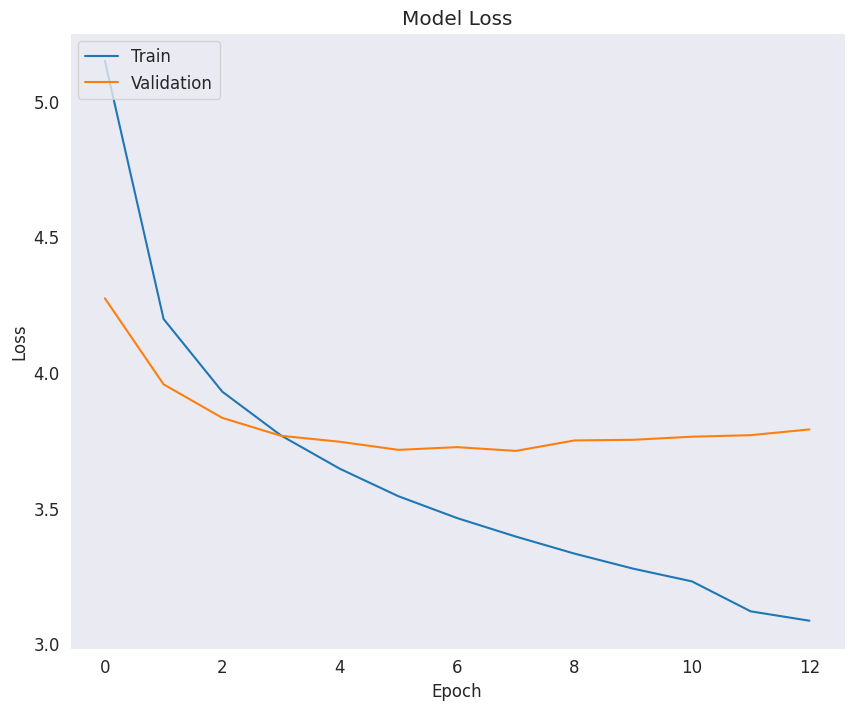

In [38]:
plt.figure(figsize=(10,8))
plt.plot(history_EfficientNetB0.history['loss'])
plt.plot(history_EfficientNetB0.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
Average BLEU-1 Score: 0.303030303030303
Average BLEU-2 Score: 0.05838650961174983
Average BLEU-3 Score: 0.036304312770436976


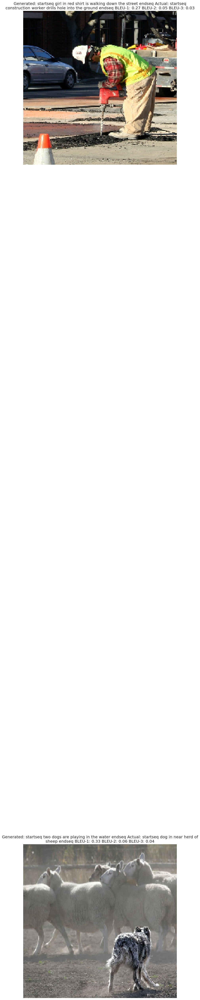

In [22]:
# Tokenize actual and generated captions
def tokenize_caption(caption):
    return caption.split()

# Function to calculate BLEU-1, BLEU-2, and BLEU-3 scores for each generated caption
def calculate_bleu_scores(reference, hypothesis):
    reference = [tokenize_caption(reference)]
    hypothesis = tokenize_caption(hypothesis)

    # Smoothing function to handle zero-division errors in BLEU calculation
    smoothing_function = SmoothingFunction().method1

    bleu1 = sentence_bleu(reference, hypothesis, weights=(1, 0, 0, 0), smoothing_function=smoothing_function)
    bleu2 = sentence_bleu(reference, hypothesis, weights=(0.5, 0.5, 0, 0), smoothing_function=smoothing_function)
    bleu3 = sentence_bleu(reference, hypothesis, weights=(0.33, 0.33, 0.33, 0), smoothing_function=smoothing_function)

    return bleu1, bleu2, bleu3

# Generate captions for samples and calculate BLEU scores
samples = test.sample(2)
samples.reset_index(drop=True, inplace=True)

bleu1_scores = []
bleu2_scores = []
bleu3_scores = []

for index, record in samples.iterrows():
    img = load_img(os.path.join(image_path, record['image']), target_size=(224, 224))
    img = img_to_array(img)
    img = img / 255.

    generated_caption = predict_caption(caption_model_EfficientNetB0, record['image'], tokenizer, max_length,EfficientNetB0_features )
    samples.loc[index, 'generated_caption'] = generated_caption

    # Calculate BLEU scores
    actual_caption = record['caption']
    bleu1, bleu2, bleu3 = calculate_bleu_scores(actual_caption, generated_caption)

    bleu1_scores.append(bleu1)
    bleu2_scores.append(bleu2)
    bleu3_scores.append(bleu3)

    samples.loc[index, 'bleu1_score'] = bleu1
    samples.loc[index, 'bleu2_score'] = bleu2
    samples.loc[index, 'bleu3_score'] = bleu3

# Calculate average BLEU scores for all samples
average_bleu1_score = np.mean(bleu1_scores)
average_bleu2_score = np.mean(bleu2_scores)
average_bleu3_score = np.mean(bleu3_scores)
print("Average BLEU-1 Score:", average_bleu1_score)
print("Average BLEU-2 Score:", average_bleu2_score)
print("Average BLEU-3 Score:", average_bleu3_score)

# Display samples with actual and generated captions along with BLEU scores
def display_images_with_captions(samples, display_actual=True):
    plt.figure(figsize=(10, 100))  # Adjust figure size for better visibility
    for i in range(len(samples)):
        plt.subplot(len(samples), 1, i+1)
        img_path = os.path.join(image_path, samples.loc[i, 'image'])
        img = load_img(img_path, target_size=(224, 224))
        plt.imshow(img)
        plt.axis('off')
        title = "Generated: " + samples.loc[i, 'generated_caption']
        if display_actual:
            title += "\nActual: " + samples.loc[i, 'caption']
        title += "\nBLEU-1: {:.2f}\nBLEU-2: {:.2f}\nBLEU-3: {:.2f}".format(
            samples.loc[i, 'bleu1_score'], samples.loc[i, 'bleu2_score'], samples.loc[i, 'bleu3_score']
        )
        plt.title("\n".join(wrap(title, 100)))
    plt.show()

display_images_with_captions(samples, display_actual=True)


In [23]:

model = DenseNet201(include_top=False ,pooling='avg', input_shape=(224, 224, 3), weights='imagenet')
DenseNet201_fe = Model(inputs=resnet_model.input, outputs=resnet_model.output)

img_size = 224
features_DenseNet201 = {}

for image in tqdm(data['image'].unique().tolist()):
    img_path = os.path.join(image_path, image)
    img = load_img(img_path, target_size=(img_size, img_size))
    img = img_to_array(img)
    img = preprocess_input(img)  # Preprocess the image using the appropriate function
    img = np.expand_dims(img, axis=0)

    feature = DenseNet201_fe.predict(img, verbose=0)
    features_DenseNet201[image] = feature.flatten()  # Flatten if necessary

# Convert features dictionary to numpy array
feature_list_DenseNet201 = np.array([features_DenseNet201[img] for img in images])
print(feature_list_DenseNet201.shape)  # Check the shape to ensure correctness

74836368/74836368 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


100%|██████████| 8091/8091 [10:07<00:00, 13.31it/s]

(8091, 2048)


In [24]:
# Define the model
input1 = Input(shape=(feature_list_DenseNet201.shape[1],))  # Feature vector size
input2 = Input(shape=(max_length,))  # Caption sequence length

# Image feature model
img_features = Dense(256, activation='relu')(input1)
img_features_reshaped = Reshape((1, 256))(img_features)  # Reshape to (batch_size, 1, 256)

# Caption model
sentence_features = Embedding(vocab_size, 256, mask_zero=True)(input2)

# Ensure the shapes are compatible for concatenation
# Use Lambda to handle concatenation along the correct axis
def concat_tensor(tensors):
    img_tensor, cap_tensor = tensors
    cap_shape = tf.shape(cap_tensor)
    img_tensor = tf.tile(img_tensor, multiples=[1, cap_shape[1], 1])
    return tf.concat([img_tensor, cap_tensor], axis=2)

merged = Lambda(concat_tensor)([img_features_reshaped, sentence_features])

# Continue with LSTM and dense layers
sentence_features = LSTM(256)(merged)
x = Dropout(0.5)(sentence_features)
x = add([x, img_features])
x = Dense(128, activation='relu')(x)
x = Dropout(0.5)(x)
output = Dense(vocab_size, activation='softmax')(x)

caption_model_DenseNet201 = Model(inputs=[input1, input2], outputs=output)
caption_model_DenseNet201.compile(loss='categorical_crossentropy', optimizer='adam')

# Print model summary
caption_model_DenseNet201.summary()


Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_7       │ (None, 2048)      │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_6 (Dense)     │ (None, 256)       │    524,544 │ input_layer_7[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_layer_8       │ (None, 34)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reshape_2 (Reshape) │ (None, 1, 256)    │          0 │ dense_6[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_2         │ (None, 34, 256)   │  2,244,608 │ input_layer_8[0]… │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ not_equal_2         │ (None, 34)        │          0 │ input_layer_8[0]… │
│ (NotEqual)          │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lambda_2 (Lambda)   │ (None, 34, 512)   │          0 │ reshape_2[0][0],  │
│                     │                   │            │ embedding_2[0][0… │
│                     │                   │            │ not_equal_2[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lstm_2 (LSTM)       │ (None, 256)       │    787,456 │ lambda_2[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_4 (Dropout) │ (None, 256)       │          0 │ lstm_2[0][0]      │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_2 (Add)         │ (None, 256)       │          0 │ dropout_4[0][0],  │
│                     │                   │            │ dense_6[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_7 (Dense)     │ (None, 128)       │     32,896 │ add_2[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_5 (Dropout) │ (None, 128)       │          0 │ dense_7[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_8 (Dense)     │ (None, 8768)      │  1,131,072 │ dropout_5[0][0]   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 4,720,576 (18.01 MB)

 Trainable params: 4,720,576 (18.01 MB)

 Non-trainable params: 0 (0.00 B)

In [25]:
train_generator = CustomDataGenerator(df=train, X_col='image', y_col='caption', batch_size=64, directory=image_path,
                                      tokenizer=tokenizer, vocab_size=vocab_size, max_length=max_length, features=features_DenseNet201)

validation_generator = CustomDataGenerator(df=test, X_col='image', y_col='caption', batch_size=64, directory=image_path,
                                      tokenizer=tokenizer, vocab_size=vocab_size, max_length=max_length, features=features_DenseNet201)
model_name = "model_Densenet.keras"
checkpoint = ModelCheckpoint(model_name,
                            monitor="val_loss",
                            mode="min",
                            save_best_only=True,
                            verbose=1)

earlystopping = EarlyStopping(monitor='val_loss', min_delta=0, patience=5, verbose=1, restore_best_weights=True)

learning_rate_reduction = ReduceLROnPlateau(monitor='val_loss',
                                            patience=3,
                                            verbose=1,
                                            factor=0.2,
                                            min_lr=0.00000001)

history_DenseNet201 = caption_model_DenseNet201.fit(
        train_generator,
        epochs=20,
        validation_data=validation_generator,
        callbacks=[checkpoint, earlystopping, learning_rate_reduction])

Epoch 1/20
538/538 ━━━━━━━━━━━━━━━━━━━━ 0s 508ms/step - loss: 5.6715
Epoch 1: val_loss improved from inf to 4.22554, saving model to model_Densenet.keras
538/538 ━━━━━━━━━━━━━━━━━━━━ 328s 600ms/step - loss: 5.6703 - val_loss: 4.2255 - learning_rate: 0.0010
Epoch 2/20
538/538 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 4.2262
Epoch 2: val_loss improved from 4.22554 to 3.91774, saving model to model_Densenet.keras
538/538 ━━━━━━━━━━━━━━━━━━━━ 86s 158ms/step - loss: 4.2261 - val_loss: 3.9177 - learning_rate: 0.0010
Epoch 3/20
538/538 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step - loss: 3.9297
Epoch 3: val_loss improved from 3.91774 to 3.78668, saving model to model_Densenet.keras
538/538 ━━━━━━━━━━━━━━━━━━━━ 85s 157ms/step - loss: 3.9297 - val_loss: 3.7867 - learning_rate: 0.0010
Epoch 4/20
538/538 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - loss: 3.7708
Epoch 4: val_loss improved from 3.78668 to 3.72296, saving model to model_Densenet.keras
538/538 ━━━━━━━━━━━━━━━━━━━━ 86s 159ms/step - loss: 3.7708 - val_

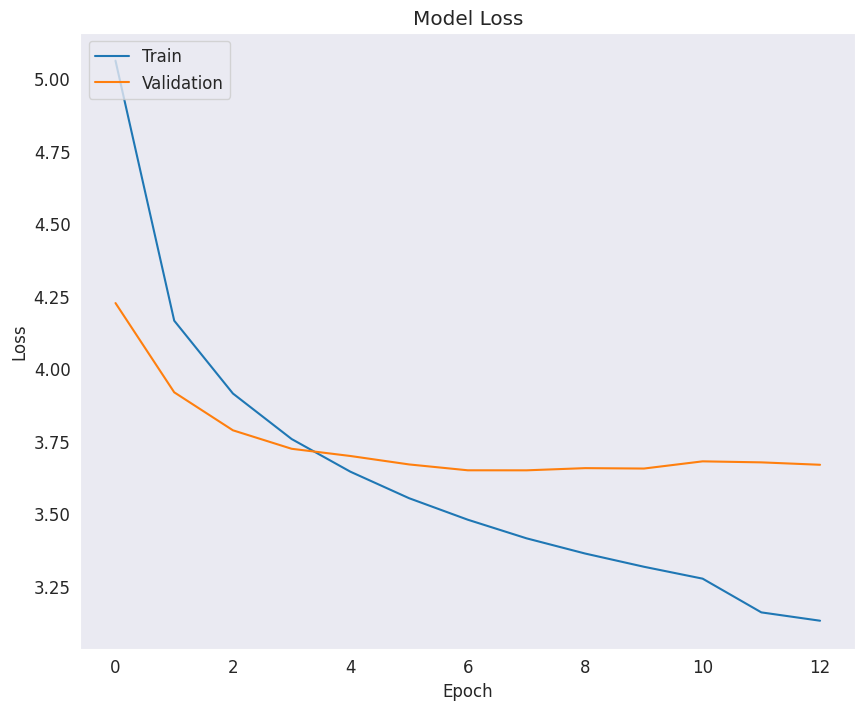

In [39]:
plt.figure(figsize=(10,8))
plt.plot(history_DenseNet201.history['loss'])
plt.plot(history_DenseNet201.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Average BLEU-1 Score: 0.4241906544948232
Average BLEU-2 Score: 0.23760249236463998
Average BLEU-3 Score: 0.18220684043470162


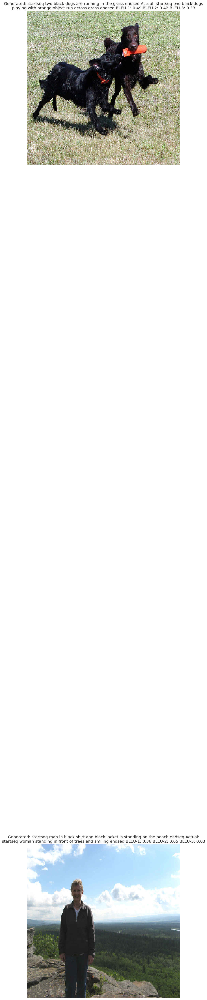

In [27]:
# Tokenize actual and generated captions
def tokenize_caption(caption):
    return caption.split()

# Function to calculate BLEU-1, BLEU-2, and BLEU-3 scores for each generated caption
def calculate_bleu_scores(reference, hypothesis):
    reference = [tokenize_caption(reference)]
    hypothesis = tokenize_caption(hypothesis)

    # Smoothing function to handle zero-division errors in BLEU calculation
    smoothing_function = SmoothingFunction().method1

    bleu1 = sentence_bleu(reference, hypothesis, weights=(1, 0, 0, 0), smoothing_function=smoothing_function)
    bleu2 = sentence_bleu(reference, hypothesis, weights=(0.5, 0.5, 0, 0), smoothing_function=smoothing_function)
    bleu3 = sentence_bleu(reference, hypothesis, weights=(0.33, 0.33, 0.33, 0), smoothing_function=smoothing_function)

    return bleu1, bleu2, bleu3

# Generate captions for samples and calculate BLEU scores
samples = test.sample(2)
samples.reset_index(drop=True, inplace=True)

bleu1_scores = []
bleu2_scores = []
bleu3_scores = []

for index, record in samples.iterrows():
    img = load_img(os.path.join(image_path, record['image']), target_size=(224, 224))
    img = img_to_array(img)
    img = img / 255.

    generated_caption = predict_caption(caption_model_DenseNet201, record['image'], tokenizer, max_length,features_DenseNet201 )
    samples.loc[index, 'generated_caption'] = generated_caption

    # Calculate BLEU scores
    actual_caption = record['caption']
    bleu1, bleu2, bleu3 = calculate_bleu_scores(actual_caption, generated_caption)

    bleu1_scores.append(bleu1)
    bleu2_scores.append(bleu2)
    bleu3_scores.append(bleu3)

    samples.loc[index, 'bleu1_score'] = bleu1
    samples.loc[index, 'bleu2_score'] = bleu2
    samples.loc[index, 'bleu3_score'] = bleu3

# Calculate average BLEU scores for all samples
average_bleu1_score = np.mean(bleu1_scores)
average_bleu2_score = np.mean(bleu2_scores)
average_bleu3_score = np.mean(bleu3_scores)
print("Average BLEU-1 Score:", average_bleu1_score)
print("Average BLEU-2 Score:", average_bleu2_score)
print("Average BLEU-3 Score:", average_bleu3_score)

# Display samples with actual and generated captions along with BLEU scores
def display_images_with_captions(samples, display_actual=True):
    plt.figure(figsize=(10, 100))  # Adjust figure size for better visibility
    for i in range(len(samples)):
        plt.subplot(len(samples), 1, i+1)
        img_path = os.path.join(image_path, samples.loc[i, 'image'])
        img = load_img(img_path, target_size=(224, 224))
        plt.imshow(img)
        plt.axis('off')
        title = "Generated: " + samples.loc[i, 'generated_caption']
        if display_actual:
            title += "\nActual: " + samples.loc[i, 'caption']
        title += "\nBLEU-1: {:.2f}\nBLEU-2: {:.2f}\nBLEU-3: {:.2f}".format(
            samples.loc[i, 'bleu1_score'], samples.loc[i, 'bleu2_score'], samples.loc[i, 'bleu3_score']
        )
        plt.title("\n".join(wrap(title, 100)))
    plt.show()

display_images_with_captions(samples, display_actual=True)


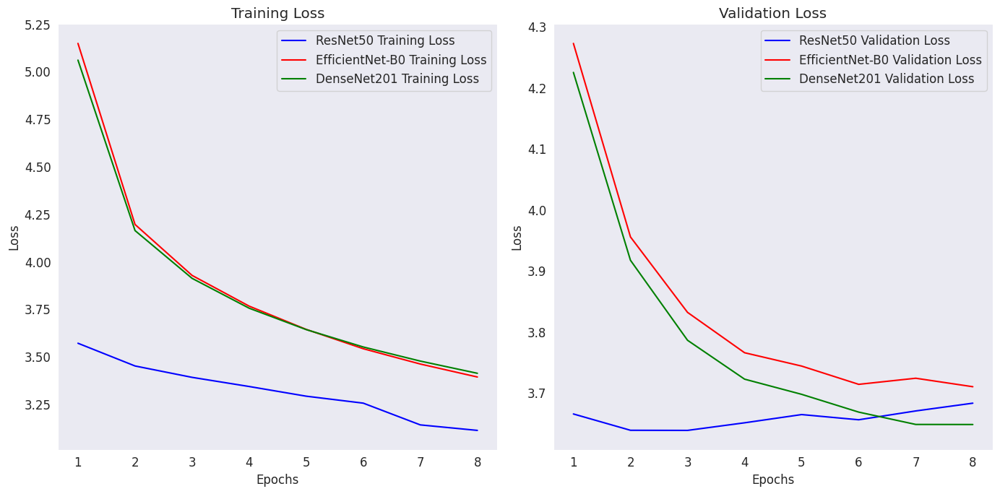

In [29]:


# Extract loss values
resnet_train_loss = history_resnet.history['loss']
resnet_val_loss = history_resnet.history['val_loss']

efficientnet_train_loss = history_EfficientNetB0.history['loss']
efficientnet_val_loss = history_EfficientNetB0.history['val_loss']

densenet_train_loss = history_DenseNet201.history['loss']
densenet_val_loss = history_DenseNet201.history['val_loss']

# Determine the minimum number of epochs for consistent plotting
min_epochs = min(len(resnet_train_loss), len(resnet_val_loss), 
                 len(efficientnet_train_loss), len(efficientnet_val_loss), 
                 len(densenet_train_loss), len(densenet_val_loss))
epochs = range(1, min_epochs + 1)

# Plot training loss
plt.figure(figsize=(14, 7))

plt.subplot(1, 2, 1)
plt.plot(epochs, resnet_train_loss[:min_epochs], label='ResNet50 Training Loss', color='b')
plt.plot(epochs, efficientnet_train_loss[:min_epochs], label='EfficientNet-B0 Training Loss', color='r')
plt.plot(epochs, densenet_train_loss[:min_epochs], label='DenseNet201 Training Loss', color='g')
plt.title('Training Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Plot validation loss
plt.subplot(1, 2, 2)
plt.plot(epochs, resnet_val_loss[:min_epochs], label='ResNet50 Validation Loss', color='b')
plt.plot(epochs, efficientnet_val_loss[:min_epochs], label='EfficientNet-B0 Validation Loss', color='r')
plt.plot(epochs, densenet_val_loss[:min_epochs], label='DenseNet201 Validation Loss', color='g')
plt.title('Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()


In [31]:
samples = test.sample(30)
samples.reset_index(drop=True, inplace=True)

In [32]:
# Function to convert integer to word
def idx_to_word(integer, tokenizer):
    """Convert an integer to a word."""
    for word, index in tokenizer.word_index.items():
        if index == integer:
            return word
    return None

# Function to predict caption for a given image
def predict_caption(model, image_filename, tokenizer, max_length, features):
    """Predict a caption for a given image."""
    feature = features.get(image_filename)
    if feature is None:
        return "Feature not found"
    in_text = "startseq"
    for i in range(max_length):
        sequence = tokenizer.texts_to_sequences([in_text])[0]
        sequence = pad_sequences([sequence], maxlen=max_length)
        y_pred = model.predict([np.array([feature]), sequence])
        y_pred = np.argmax(y_pred)
        word = idx_to_word(y_pred, tokenizer)
        if word is None:
            break
        in_text += " " + word
        if word == 'endseq':
            break
    return in_text

# Tokenize actual and generated captions
def tokenize_caption(caption):
    return caption.split()

# Function to calculate BLEU scores
def calculate_bleu_scores(reference, hypothesis):
    reference = [tokenize_caption(reference)]
    hypothesis = tokenize_caption(hypothesis)
    # Smoothing function to handle zero-division errors in BLEU calculation
    smoothing_function = SmoothingFunction().method1
    bleu1 = sentence_bleu(reference, hypothesis, weights=(1, 0, 0, 0), smoothing_function=smoothing_function)
    bleu2 = sentence_bleu(reference, hypothesis, weights=(0.5, 0.5, 0, 0), smoothing_function=smoothing_function)
    bleu3 = sentence_bleu(reference, hypothesis, weights=(0.33, 0.33, 0.33, 0), smoothing_function=smoothing_function)
    return bleu1, bleu2, bleu3

# Update to remove base directory from image_path
def get_image_filename(full_path):
    return os.path.basename(full_path)

# List of image paths for the test samples
base_image_path = '/kaggle/input/flickr8k/Images/'
image_filenames = [get_image_filename(img) for img in samples['image'].tolist()]

# Generate captions for samples and calculate BLEU scores
bleu1_scores = []
bleu2_scores = []
bleu3_scores = []

for index, record in samples.iterrows():
    image_filename = get_image_filename(record['image'])
    
    generated_caption_resnet = predict_caption(caption_model_resnet, image_filename, tokenizer, max_length, features_resnet)
    generated_caption_efficientnet = predict_caption(caption_model_EfficientNetB0, image_filename, tokenizer, max_length, EfficientNetB0_features)
    generated_caption_densenet = predict_caption(caption_model_DenseNet201, image_filename, tokenizer, max_length, features_DenseNet201)

    samples.loc[index, 'generated_caption_resnet'] = generated_caption_resnet
    samples.loc[index, 'generated_caption_efficientnet'] = generated_caption_efficientnet
    samples.loc[index, 'generated_caption_densenet'] = generated_caption_densenet

    # Calculate BLEU scores for each model
    actual_caption = record['caption']

    bleu1_resnet, bleu2_resnet, bleu3_resnet = calculate_bleu_scores(actual_caption, generated_caption_resnet)
    bleu1_efficientnet, bleu2_efficientnet, bleu3_efficientnet = calculate_bleu_scores(actual_caption, generated_caption_efficientnet)
    bleu1_densenet, bleu2_densenet, bleu3_densenet = calculate_bleu_scores(actual_caption, generated_caption_densenet)

    bleu1_scores.append((bleu1_resnet, bleu1_efficientnet, bleu1_densenet))
    bleu2_scores.append((bleu2_resnet, bleu2_efficientnet, bleu2_densenet))
    bleu3_scores.append((bleu3_resnet, bleu3_efficientnet, bleu3_densenet))

    samples.loc[index, 'bleu1_score_resnet'] = bleu1_resnet
    samples.loc[index, 'bleu2_score_resnet'] = bleu2_resnet
    samples.loc[index, 'bleu3_score_resnet'] = bleu3_resnet

    samples.loc[index, 'bleu1_score_efficientnet'] = bleu1_efficientnet
    samples.loc[index, 'bleu2_score_efficientnet'] = bleu2_efficientnet
    samples.loc[index, 'bleu3_score_efficientnet'] = bleu3_efficientnet

    samples.loc[index, 'bleu1_score_densenet'] = bleu1_densenet
    samples.loc[index, 'bleu2_score_densenet'] = bleu2_densenet
    samples.loc[index, 'bleu3_score_densenet'] = bleu3_densenet

# Calculate average BLEU scores for all samples
average_bleu1_scores = np.mean(bleu1_scores, axis=0)
average_bleu2_scores = np.mean(bleu2_scores, axis=0)
average_bleu3_scores = np.mean(bleu3_scores, axis=0)

print("Average BLEU-1 Scores: ResNet50:", average_bleu1_scores[0], ", EfficientNet-B0:", average_bleu1_scores[1], ", DenseNet201:", average_bleu1_scores[2])
print("Average BLEU-2 Scores: ResNet50:", average_bleu2_scores[0], ", EfficientNet-B0:", average_bleu2_scores[1], ", DenseNet201:", average_bleu2_scores[2])
print("Average BLEU-3 Scores: ResNet50:", average_bleu3_scores[0], ", EfficientNet-B0:", average_bleu3_scores[1], ", DenseNet201:", average_bleu3_scores[2])

# Display samples with actual and generated captions along with BLEU scores
def display_images_with_captions(samples, display_actual=True):
    plt.figure(figsize=(10, 100))  # Adjust figure size for better visibility
    for i in range(len(samples)):
        plt.subplot(len(samples), 1, i+1)
        img_path = os.path.join(base_image_path, samples.loc[i, 'image'])
        img = load_img(img_path, target_size=(224, 224))
        plt.imshow(img)
        plt.axis('off')
        title = "Generated (ResNet50): " + samples.loc[i, 'generated_caption_resnet']
        title += "\nGenerated (EfficientNet-B0): " + samples.loc[i, 'generated_caption_efficientnet']
        title += "\nGenerated (DenseNet201): " + samples.loc[i, 'generated_caption_densenet']
        if display_actual:
            title += "\nActual: " + samples.loc[i, 'caption']
        title += "\nBLEU-1 (ResNet50): {:.2f}, BLEU-2 (ResNet50): {:.2f}, BLEU-3 (ResNet50): {:.2f}".format(
            samples.loc[i, 'bleu1_score_resnet'], samples.loc[i, 'bleu2_score_resnet'], samples.loc[i, 'bleu3_score_resnet']
        )
        title += "\nBLEU-1 (EfficientNet-B0): {:.2f}, BLEU-2 (EfficientNet-B0): {:.2f}, BLEU-3 (EfficientNet-B0): {:.2f}".format(
            samples.loc[i, 'bleu1_score_efficientnet'], samples.loc[i, 'bleu2_score_efficientnet'], samples.loc[i, 'bleu3_score_efficientnet']
        )
        title += "\nBLEU-1 (DenseNet201): {:.2f}, BLEU-2 (DenseNet201): {:.2f}, BLEU-3 (DenseNet201): {:.2f}".format(
            samples.loc[i, 'bleu1_score_densenet'], samples.loc[i, 'bleu2_score_densenet'], samples.loc[i, 'bleu3_score_densenet']
        )
        plt.title("\n".join(wrap(title, 100)))
    plt.show()

#display_images_with_captions(samples, display_actual=True)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━

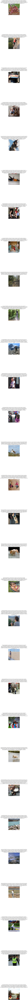

In [44]:

# Function to convert integer to word
def idx_to_word(integer, tokenizer):
    """Convert an integer to a word."""
    for word, index in tokenizer.word_index.items():
        if index == integer:
            return word
    return None

# Function to predict caption for a given image
def predict_caption(model, image_filename, tokenizer, max_length, features):
    """Predict a caption for a given image."""
    feature = features.get(image_filename)
    if feature is None:
        return "Feature not found"
    in_text = "startseq"
    for i in range(max_length):
        sequence = tokenizer.texts_to_sequences([in_text])[0]
        sequence = pad_sequences([sequence], maxlen=max_length)
        y_pred = model.predict([np.array([feature]), sequence])
        y_pred = np.argmax(y_pred)
        word = idx_to_word(y_pred, tokenizer)
        if word is None:
            break
        in_text += " " + word
        if word == 'endseq':
            break
    return in_text

# Tokenize actual and generated captions
def tokenize_caption(caption):
    return caption.split()

# Function to calculate BLEU scores
def calculate_bleu_scores(reference, hypothesis):
    reference = [tokenize_caption(reference)]
    hypothesis = tokenize_caption(hypothesis)
    # Smoothing function to handle zero-division errors in BLEU calculation
    smoothing_function = SmoothingFunction().method1
    bleu1 = sentence_bleu(reference, hypothesis, weights=(1, 0, 0, 0), smoothing_function=smoothing_function)
    bleu2 = sentence_bleu(reference, hypothesis, weights=(0.5, 0.5, 0, 0), smoothing_function=smoothing_function)
    bleu3 = sentence_bleu(reference, hypothesis, weights=(0.33, 0.33, 0.33, 0), smoothing_function=smoothing_function)
    return bleu1, bleu2, bleu3

# Update to remove base directory from image_path
def get_image_filename(full_path):
    return os.path.basename(full_path)

# List of image paths for the test samples
base_image_path = '/kaggle/input/flickr8k/Images/'
image_filenames = [get_image_filename(img) for img in samples['image'].tolist()]

# Generate captions for samples and calculate BLEU scores
bleu1_scores = []
bleu2_scores = []
bleu3_scores = []

for index, record in samples.iterrows():
    image_filename = get_image_filename(record['image'])
    
    generated_caption_resnet = predict_caption(caption_model_resnet, image_filename, tokenizer, max_length, features_resnet)
    generated_caption_efficientnet = predict_caption(caption_model_EfficientNetB0, image_filename, tokenizer, max_length, EfficientNetB0_features)
    generated_caption_densenet = predict_caption(caption_model_DenseNet201, image_filename, tokenizer, max_length, features_DenseNet201)

    samples.loc[index, 'generated_caption_resnet'] = generated_caption_resnet
    samples.loc[index, 'generated_caption_efficientnet'] = generated_caption_efficientnet
    samples.loc[index, 'generated_caption_densenet'] = generated_caption_densenet

    # Calculate BLEU scores for each model
    actual_caption = record['caption']

    bleu1_resnet, bleu2_resnet, bleu3_resnet = calculate_bleu_scores(actual_caption, generated_caption_resnet)
    bleu1_efficientnet, bleu2_efficientnet, bleu3_efficientnet = calculate_bleu_scores(actual_caption, generated_caption_efficientnet)
    bleu1_densenet, bleu2_densenet, bleu3_densenet = calculate_bleu_scores(actual_caption, generated_caption_densenet)

    bleu1_scores.append((bleu1_resnet, bleu1_efficientnet, bleu1_densenet))
    bleu2_scores.append((bleu2_resnet, bleu2_efficientnet, bleu2_densenet))
    bleu3_scores.append((bleu3_resnet, bleu3_efficientnet, bleu3_densenet))

    samples.loc[index, 'bleu1_score_resnet'] = bleu1_resnet
    samples.loc[index, 'bleu2_score_resnet'] = bleu2_resnet
    samples.loc[index, 'bleu3_score_resnet'] = bleu3_resnet

    samples.loc[index, 'bleu1_score_efficientnet'] = bleu1_efficientnet
    samples.loc[index, 'bleu2_score_efficientnet'] = bleu2_efficientnet
    samples.loc[index, 'bleu3_score_efficientnet'] = bleu3_efficientnet

    samples.loc[index, 'bleu1_score_densenet'] = bleu1_densenet
    samples.loc[index, 'bleu2_score_densenet'] = bleu2_densenet
    samples.loc[index, 'bleu3_score_densenet'] = bleu3_densenet

# Calculate average BLEU scores for all samples
average_bleu1_scores = np.mean(bleu1_scores, axis=0)
average_bleu2_scores = np.mean(bleu2_scores, axis=0)
average_bleu3_scores = np.mean(bleu3_scores, axis=0)

print("Average BLEU-1 Scores: ResNet50:", average_bleu1_scores[0], ", EfficientNet-B0:", average_bleu1_scores[1], ", DenseNet201:", average_bleu1_scores[2])
print("Average BLEU-2 Scores: ResNet50:", average_bleu2_scores[0], ", EfficientNet-B0:", average_bleu2_scores[1], ", DenseNet201:", average_bleu2_scores[2])
print("Average BLEU-3 Scores: ResNet50:", average_bleu3_scores[0], ", EfficientNet-B0:", average_bleu3_scores[1], ", DenseNet201:", average_bleu3_scores[2])

# Display samples with actual and generated captions along with BLEU scores
def display_images_with_captions(samples, display_actual=True):
    plt.figure(figsize=(300,500))  # Adjust figure size for better visibility
    for i in range(len(samples)):
        plt.subplot(len(samples), 1, i + 1)
        img_path = os.path.join(base_image_path, samples.loc[i, 'image'])
        img = load_img(img_path, target_size=(224, 224))
        plt.imshow(img)
        plt.axis('off')
        title = "Generated (ResNet50):\n" + samples.loc[i, 'generated_caption_resnet']
        title += "\n\nGenerated (EfficientNet-B0):\n" + samples.loc[i, 'generated_caption_efficientnet']
        title += "\n\nGenerated (DenseNet201):\n" + samples.loc[i, 'generated_caption_densenet']
        if display_actual:
            title += "\n\nActual:\n" + samples.loc[i, 'caption']
        title += "\n\nBLEU-1 (ResNet50): {:.2f}\nBLEU-2 (ResNet50): {:.2f}\nBLEU-3 (ResNet50): {:.2f}".format(
            samples.loc[i, 'bleu1_score_resnet'], samples.loc[i, 'bleu2_score_resnet'], samples.loc[i, 'bleu3_score_resnet']
        )
        title += "\n\nBLEU-1 (EfficientNet-B0): {:.2f}\nBLEU-2 (EfficientNet-B0): {:.2f}\nBLEU-3 (EfficientNet-B0): {:.2f}".format(
            samples.loc[i, 'bleu1_score_efficientnet'], samples.loc[i, 'bleu2_score_efficientnet'], samples.loc[i, 'bleu3_score_efficientnet']
        )
        title += "\n\nBLEU-1 (DenseNet201): {:.2f}\nBLEU-2 (DenseNet201): {:.2f}\nBLEU-3 (DenseNet201): {:.2f}".format(
            samples.loc[i, 'bleu1_score_densenet'], samples.loc[i, 'bleu2_score_densenet'], samples.loc[i, 'bleu3_score_densenet']
        )
        plt.title("\n".join(wrap(title, 100)))
    plt.subplots_adjust(hspace=2)  # Add space between subplots
    plt.show()

display_images_with_captions(samples, display_actual=True)
